In [1]:
import pandas as pd
import numpy as np
import folium
import requests
from folium import plugins
import seaborn as sns
import matplotlib.pyplot as plt
#Setting Pandas to show all solumns without truncation
pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

In [2]:
#Importing Crimes Dataset
df = pd.read_csv('../input/new-york-crime-data/ny.csv')
df.head()

,CMPLNT_NUM,ADDR_PCT_CD,BORO_NM,CMPLNT_FR_DT,CMPLNT_FR_TM,CMPLNT_TO_DT,CMPLNT_TO_TM,CRM_ATPT_CPTD_CD,HADEVELOPT,HOUSING_PSA,JURISDICTION_CODE,JURIS_DESC,KY_CD,LAW_CAT_CD,LOC_OF_OCCUR_DESC,OFNS_DESC,PARKS_NM,PATROL_BORO,PD_CD,PD_DESC,PREM_TYP_DESC,RPT_DT,STATION_NAME,SUSP_AGE_GROUP,SUSP_RACE,SUSP_SEX,TRANSIT_DISTRICT,VIC_AGE_GROUP,VIC_RACE,VIC_SEX,X_COORD_CD,Y_COORD_CD,Latitude,Longitude,Lat_Lon
0,466502077,75,BROOKLYN,03/30/2020,17:30:00,03/31/2020,06:53:00,COMPLETED,NaN,NaN,0.0,N.Y. POLICE DEPT,341,MISDEMEANOR,OPPOSITE OF,PETIT LARCENY,NaN,PATROL BORO BKLYN NORTH,321.0,"LARCENY,PETIT FROM AUTO",STREET,03/31/2020,NaN,NaN,NaN,NaN,NaN,25-44,BLACK,M,1018496,178657,40.656991,-73.876574,"(40.65699087900003, -73.87657444799999)"
1,303191835,77,BROOKLYN,03/28/2020,19:30:00,03/28/2020,20:30:00,COMPLETED,NaN,NaN,0.0,N.Y. POLICE DEPT,104,FELONY,OPPOSITE OF,RAPE,NaN,PATROL BORO BKLYN NORTH,157.0,RAPE 1,STREET,03/30/2020,NaN,18-24,UNKNOWN,M,NaN,<18,UNKNOWN,F,1003606,185050,40.674583,-73.930222,"(40.67458330800008, -73.93022154099998)"
2,735488557,43,BRONX,03/29/2020,14:10:00,NaN,NaN,COMPLETED,NaN,NaN,0.0,N.Y. POLICE DEPT,341,MISDEMEANOR,INSIDE,PETIT LARCENY,NaN,PATROL BORO BRONX,333.0,"LARCENY,PETIT FROM STORE-SHOPL",DRUG STORE,03/29/2020,NaN,NaN,NaN,NaN,NaN,UNKNOWN,UNKNOWN,D,1019853,241853,40.830443,-73.871349,"(40.83044253800006, -73.871349147)"
3,315962428,40,BRONX,03/29/2020,07:10:00,03/29/2020,07:16:00,COMPLETED,NaN,NaN,0.0,N.Y. POLICE DEPT,341,MISDEMEANOR,INSIDE,PETIT LARCENY,NaN,PATROL BORO BRONX,333.0,"LARCENY,PETIT FROM STORE-SHOPL",GROCERY/BODEGA,03/29/2020,NaN,UNKNOWN,BLACK,M,NaN,25-44,WHITE HISPANIC,F,1007236,237260,40.817878,-73.916957,"(40.817877907000025, -73.91695668199996)"
4,165437868,114,QUEENS,03/27/2020,13:15:00,03/27/2020,14:00:00,COMPLETED,NaN,NaN,0.0,N.Y. POLICE DEPT,344,MISDEMEANOR,INSIDE,ASSAULT 3 & RELATED OFFENSES,NaN,PATROL BORO QUEENS NORTH,101.0,ASSAULT 3,OTHER,03/27/2020,NaN,NaN,NaN,NaN,NaN,45-64,BLACK,F,1002018,213258,40.752011,-73.935872,"(40.75201086000004, -73.93587196099996)"


## Data Preparation / Understanding

In [3]:
#Count of incidents that happened before 2020
len(df[~df['CMPLNT_FR_DT'].str.contains('2020')])

5750

#### We notice that our data contains 5750 Incidents that didn't happen in 2020 so we are going to remove it
#### Because the Dataset is large and later on we are going to use Foursquare (Personal Tier with limited Calls) we are only going to keep Felonies (and discard misdemeanours and violations)

In [4]:
#we will keep a copy of all the Offenses
complete_df = df
df = df[df['CMPLNT_FR_DT'].str.contains('2020') & (df['LAW_CAT_CD'] == 'FELONY')]
df.shape

(31303, 35)

#### We Have many unecessary columns so we will be only keeping the ones we need:
* BORO_NM: Borough where the Incident took place (Brooklyn, Manhattan..)
* OFNS_DESC: Offense Description (Burglary, grand larceny..)
* SUSP_RACE: Race of the Suspect
* VIC_AGE_GROUP: Victim's age group
* VIC_SEX: Victim's sex
* Latitude, Longitude: Coordinates of the nearest intersection where the incident took place (For anonymization reasons)

In [5]:
#Removing unecessary Columns
df = df[['BORO_NM', 'OFNS_DESC', 'SUSP_RACE', 'VIC_AGE_GROUP', 'VIC_SEX', 'Latitude', 'Longitude']]
complete_df = complete_df[['BORO_NM', 'LAW_CAT_CD', 'OFNS_DESC', 'SUSP_RACE', 'VIC_AGE_GROUP', 'VIC_SEX', 'Latitude', 'Longitude']]
#Renaming columns
df.columns = ['Borough', 'Offense', 'Suspect_race', 'Victim_age_group', 'Victim_sex', 'Latitude', 'Longitude']
complete_df.columns = ['Borough', 'Offense_category', 'Offense', 'Suspect_race', 'Victim_age_group', 'Victim_sex', 'Latitude', 'Longitude']
#Reseting the index
df.reset_index(drop = True, inplace = True)
complete_df.reset_index(drop = True, inplace = True)
df.head()

,Borough,Offense,Suspect_race,Victim_age_group,Victim_sex,Latitude,Longitude
0,BROOKLYN,RAPE,UNKNOWN,<18,F,40.674583,-73.930222
1,BRONX,DANGEROUS WEAPONS,BLACK,UNKNOWN,E,40.840977,-73.899175
2,BROOKLYN,DANGEROUS WEAPONS,BLACK,UNKNOWN,E,40.663914,-73.950977
3,BRONX,MISCELLANEOUS PENAL LAW,BLACK,25-44,F,40.889138,-73.862020
4,BRONX,ROBBERY,BLACK,18-24,F,40.814771,-73.925111


#### Checking Null values in our data

In [6]:
df.isnull().sum()

Borough               62
Offense                0
Suspect_race        8093
Victim_age_group       0
Victim_sex             0
Latitude               0
Longitude              0
dtype: int64

#### We have 62 Incidents that have Unknown Boroughs and 8093 Incidents with Unknown Suspect_Race
#### let's Replace the null values in both rows with "UNKNOWN"

In [7]:
df.fillna('UNKNOWN', inplace=True)
complete_df.fillna('UNKNOWN', inplace=True)
df.isnull().sum()

Borough             0
Offense             0
Suspect_race        0
Victim_age_group    0
Victim_sex          0
Latitude            0
Longitude           0
dtype: int64

In [8]:
df.describe(include = 'all')

,Borough,Offense,Suspect_race,Victim_age_group,Victim_sex,Latitude,Longitude
count,31303,31303,31303,31303,31303,31303.000000,31303.000000
unique,6,25,7,6,4,NaN,NaN
top,BROOKLYN,GRAND LARCENY,UNKNOWN,25-44,M,NaN,NaN
freq,9481,8726,15061,11433,12605,NaN,NaN
mean,NaN,NaN,NaN,NaN,NaN,40.734573,-73.921306
std,NaN,NaN,NaN,NaN,NaN,0.080675,0.075203
min,NaN,NaN,NaN,NaN,NaN,40.500216,-74.252941
25%,NaN,NaN,NaN,NaN,NaN,40.674583,-73.970759
50%,NaN,NaN,NaN,NaN,NaN,40.730220,-73.925471
75%,NaN,NaN,NaN,NaN,NaN,40.807686,-73.879998


### Now let's use Foursquare to get top 20 venues within 100 meters of each Incident 

#### Foursquare Credentials and Version

In [9]:
CLIENT_ID = '3WIJBXAPR5DQW0J5GCET20IRJUHLMLGF13HGZ4RL1OE5Z3OL' #  Foursquare ID
CLIENT_SECRET = '4JHKEBFD1O53ROXFBTNL1LDSY15CUCI0DAESYNPW2LWQSC0P' # Foursquare Secret
VERSION = '20180605' # Foursquare API version
LIMIT = 20 # limit of number of venues returned by Foursquare API
radius = 100 # radius in meters

In [10]:
# Nearby Venues for each incident
venues_list=[]
incident = 1
for i in range(0, len(df)):
    # create the API request URL
    url = 'https://api.foursquare.com/v2/venues/explore?&client_id={}&client_secret={}&v={}&ll={},{}&radius={}&limit={}'.format(
        CLIENT_ID, 
        CLIENT_SECRET, 
        VERSION, 
        df['Latitude'].iloc[i], 
        df['Longitude'].iloc[i], 
        radius, 
        LIMIT)

    # make the GET request
    try:
        results = requests.get(url).json()["response"]['groups'][0]['items']
    except KeyError:
        #API Didn't return a response
        continue
    
    # return only relevant information for each nearby venue
    venues_list.append([(
        v['venue']['name'], 
        v['venue']['location']['lat'], 
        v['venue']['location']['lng'],  
        v['venue']['categories'][0]['name'],
        df['Offense'].iloc[i],
        df['Suspect_race'].iloc[i],
        df['Victim_age_group'].iloc[i],
        df['Victim_sex'].iloc[i],
        incident) for v in results])
venues = pd.DataFrame([item for venue_list in venues_list for item in venue_list])
venues.columns = [
              'Venue', 
              'Venue Latitude', 
              'Venue Longitude', 
              'Venue Category',
              'Offense',
              'Suspect_race',
              'Victim_age_group',
              'Victim_sex',
              'Incidents_count']

In [11]:
print(venues.shape)
venues.head()

(98913, 9)


,Venue,Venue Latitude,Venue Longitude,Venue Category,Offense,Suspect_race,Victim_age_group,Victim_sex,Incidents_count
0,Foto Care,40.741982,-73.992330,Camera Store,GRAND LARCENY,BLACK,UNKNOWN,D,1
1,World Seido Karate Honbu,40.742576,-73.992042,Martial Arts Dojo,GRAND LARCENY,BLACK,UNKNOWN,D,1
2,Patisserie Chanson,40.741713,-73.990543,Dessert Shop,GRAND LARCENY,BLACK,UNKNOWN,D,1
3,Foursquare Roof Deck,40.741945,-73.991878,Roof Deck,GRAND LARCENY,BLACK,UNKNOWN,D,1
4,Deep Indian Kitchen,40.742025,-73.990558,Indian Restaurant,GRAND LARCENY,BLACK,UNKNOWN,D,1


In [12]:
venues['Venue Category'].unique()

array(['Camera Store', 'Martial Arts Dojo', 'Dessert Shop', 'Roof Deck',
       'Indian Restaurant', 'Yoga Studio',
       'Vegetarian / Vegan Restaurant', 'Coffee Shop', 'Dance Studio',
       'Arts & Crafts Store', 'Salon / Barbershop', 'Art Museum',
       "Women's Store", 'Supermarket', "Men's Store", 'Art Gallery',
       'Clothing Store', 'Boutique', 'Discount Store', 'Deli / Bodega',
       'Sandwich Place', 'Ice Cream Shop', 'Fast Food Restaurant',
       'Donut Shop', 'Market', 'Mexican Restaurant', 'Pizza Place',
       'Gift Shop', 'Bakery', 'American Restaurant', 'Sushi Restaurant',
       'Vietnamese Restaurant', 'Cosmetics Shop', 'Bar',
       'French Restaurant', 'Optical Shop', 'Café', 'Taco Place',
       'Grocery Store', 'Park', 'Seafood Restaurant',
       'Gym / Fitness Center', 'Outdoor Sculpture', 'Bank',
       'Italian Restaurant', 'Wings Joint', 'Latin American Restaurant',
       'Shoe Store', 'Fried Chicken Joint', 'Pharmacy', 'Moving Target',
       'Burrito

#### We notice many types of Restaurants, let's change them all to 'Restaurant'

In [13]:
venues.loc[venues['Venue Category'].str.contains('Restaurant', case=False), 'Venue Category'] = 'Restaurant'
venues.head()

,Venue,Venue Latitude,Venue Longitude,Venue Category,Offense,Suspect_race,Victim_age_group,Victim_sex,Incidents_count
0,Foto Care,40.741982,-73.992330,Camera Store,GRAND LARCENY,BLACK,UNKNOWN,D,1
1,World Seido Karate Honbu,40.742576,-73.992042,Martial Arts Dojo,GRAND LARCENY,BLACK,UNKNOWN,D,1
2,Patisserie Chanson,40.741713,-73.990543,Dessert Shop,GRAND LARCENY,BLACK,UNKNOWN,D,1
3,Foursquare Roof Deck,40.741945,-73.991878,Roof Deck,GRAND LARCENY,BLACK,UNKNOWN,D,1
4,Deep Indian Kitchen,40.742025,-73.990558,Restaurant,GRAND LARCENY,BLACK,UNKNOWN,D,1


### Let's Extract two new Dataframes from Venues that may be helpful later on :
* Crimes by venue 
* Crimes by venue category 

In [14]:
# One hot encoding
crimes_by_venue = venues[['Venue', 'Incidents_count', 'Venue Latitude', 'Venue Longitude', 'Offense']]
crimes_by_venue = crimes_by_venue.join(pd.get_dummies(crimes_by_venue['Offense']))
crimes_by_venue.drop('Offense', axis = 1, inplace = True)
crimes_by_venue[crimes_by_venue.columns[4:]] = crimes_by_venue[crimes_by_venue.columns[4:]].astype('int')
crimes_by_venue = crimes_by_venue.groupby(['Venue Latitude', 'Venue Longitude', 'Venue']).sum().sort_values(by = 'Incidents_count', ascending = False).reset_index()

crimes_by_venue_category = venues[['Venue Category', 'Incidents_count', 'Offense']]
crimes_by_venue_category = crimes_by_venue_category.join(pd.get_dummies(crimes_by_venue_category['Offense']))
crimes_by_venue_category.drop('Offense', axis = 1, inplace = True)
crimes_by_venue_category[crimes_by_venue_category.columns[1:]] = crimes_by_venue_category[crimes_by_venue_category.columns[1:]].astype('int')
crimes_by_venue_category = crimes_by_venue_category.groupby(['Venue Category']).sum().sort_values(by = 'Incidents_count', ascending = False).reset_index()
crimes_by_venue.head()

,Venue Latitude,Venue Longitude,Venue,Incidents_count,ARSON,BURGLARY,CHILD ABANDONMENT/NON SUPPORT,CRIMINAL MISCHIEF & RELATED OF,DANGEROUS DRUGS,DANGEROUS WEAPONS,FELONY ASSAULT,FELONY SEX CRIMES,FORGERY,GAMBLING,GRAND LARCENY,GRAND LARCENY OF MOTOR VEHICLE,"HOMICIDE-NEGLIGENT,UNCLASSIFIE",KIDNAPPING,KIDNAPPING & RELATED OFFENSES,MISCELLANEOUS PENAL LAW,MURDER & NON-NEGL. MANSLAUGHTER,NYS LAWS-UNCLASSIFIED FELONY,OTHER STATE LAWS (NON PENAL LA,POSSESSION OF STOLEN PROPERTY,RAPE,ROBBERY,SEX CRIMES,THEFT-FRAUD
0,40.671129,-73.882306,Wah On,225,0,6,0,0,1,2,193,0,1,0,1,1,0,0,0,2,0,0,0,0,6,1,11,0
1,40.671149,-73.882164,Bennett’s Pharmacy,224,0,6,0,0,1,2,193,0,1,0,1,0,0,0,0,2,0,0,0,0,6,1,11,0
2,40.671396,-73.881421,Golden China,223,0,5,0,0,1,2,193,0,1,0,1,0,0,0,0,2,0,0,0,0,6,1,11,0
3,40.810173,-73.924830,Dunkin',193,0,3,0,0,0,2,160,0,2,0,6,1,0,0,0,7,0,0,0,0,5,4,3,0
4,40.837514,-73.920771,El Caldero Restaurant & Sports Bar,168,0,0,0,0,0,0,162,0,0,0,0,0,0,0,0,0,0,0,0,0,5,0,1,0


### In addition to The data we have untill now, we will be needing the Population/Borough data to be able to calculate the crime rate / borough:

In [15]:
population_df = pd.read_csv('../input/nyc-population/NYC_Population_by_Borough.csv')
population_df['Borough'] = population_df['Borough'].str.upper()
population_df

,Borough,Population
0,BROOKLYN,2559903
1,MANHATTAN,1628706
2,BRONX,1418207
3,QUEENS,2253858
4,STATEN ISLAND,476143


### Let's extract Incidents count for each borough and add it to the population data frame

In [16]:
population_df = population_df.set_index('Borough').join(df[['Borough']].groupby('Borough').size().to_frame())
population_df.rename(columns={0: 'Incidents_count'}, inplace = True)
population_df.reset_index(inplace = True)
population_df['Incidents / million'] = 1000000 * population_df['Incidents_count'] / population_df['Population']
population_df['Incidents / million'] = population_df['Incidents / million'].astype('int')
population_df

,Borough,Population,Incidents_count,Incidents / million
0,BROOKLYN,2559903,9481,3703
1,MANHATTAN,1628706,7767,4768
2,BRONX,1418207,6308,4447
3,QUEENS,2253858,6677,2962
4,STATEN ISLAND,476143,1008,2117


### New York Census Data

In [17]:
census_df = pd.read_csv('../input/new-york-census/ny_census.csv')
census_df

,Borough,Percentage of Persons in Poverty,Per Capita Income,Median Household Income
0,BROOKLYN,18.9,31984,56015
1,MANHATTAN,15.6,72832,82459
2,BRONX,27.3,20850,38085
3,QUEENS,11.6,30289,64987
4,STATEN ISLAND,11.7,34987,79267


# Exploratory Data Analysis

#### Understanding the Crime's Distribution across the Boroughs

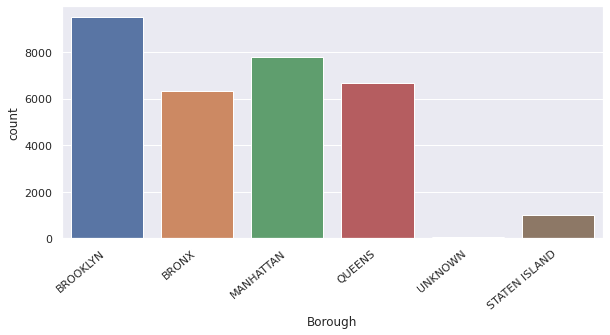

In [18]:
#Incidents by Boroughs
sns.set(rc={'figure.figsize':(9.7,4.27)})
ax = sns.countplot(x="Borough", data=df)
dmp = ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")

### A more significative stat is the Incidents / Million:

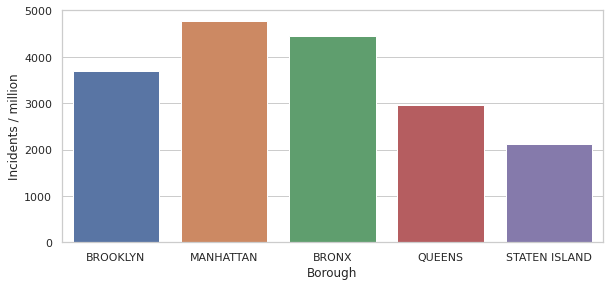

In [19]:
#Incidents_rate / Million by Boroughs
sns.set(style="whitegrid")
ax = sns.barplot(x="Borough", y="Incidents / million", data=population_df)

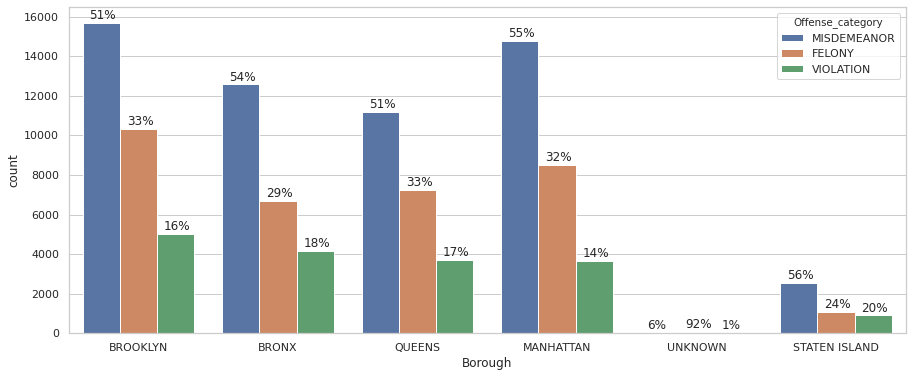

In [20]:
plt.figure(figsize=(15, 6))
ax = sns.countplot(x="Borough", hue="Offense_category", data=complete_df)
# Adding Percentages
height_bins = [0 for i in range(0, 6)]
cnt = 0
for p in ax.patches:
    height_bins[cnt % 6] += p.get_height()
    cnt += 1

cnt = 0
for p in ax.patches:
    width, height = p.get_width(), p.get_height()
    x, y = p.get_xy()
    ax.annotate('{:.0%}'.format(height / height_bins[cnt % 6]), (x + 0.05, y + height + 200))
    cnt += 1

There are three levels of crime in New York State:
* **Felony**, a serious offense for which a sentence would be more than one year.
* **Misdemeanor**, an offense of which a sentence in excess of 15 days but not greater than one year may be imposed.
* **Violation**, a lesser offense for which a sentence only be no more than 15 days.

From the graph above:
* **Misdemeanor** is the most popular level of crime in each borough, and it consists a similar percentage in each group (about 51% to 56%; Manhattan has the highest percentage of 55%).
* **Felony** The second popular.
* **Violation** The third popular.

Other Observations:
* Staten Island has a substantially lower percentage of Felony than the other 4 boroughs (which have about 31%). 
* This could mean that Staten Island is a much more peaceful area, with not only a lower total crime number but also less serious ones. 
* This also means that the Violation level of crime in Staten Island has a much higher percentage than all the other areas.
* Bronx also has a smaller percentage of Felony types of crime than the other 3 popular boroughs. This could mean that most of the crime that happens in Bronx is not pressing. This insight can affect the common belief of neighborhood security of Bronx.

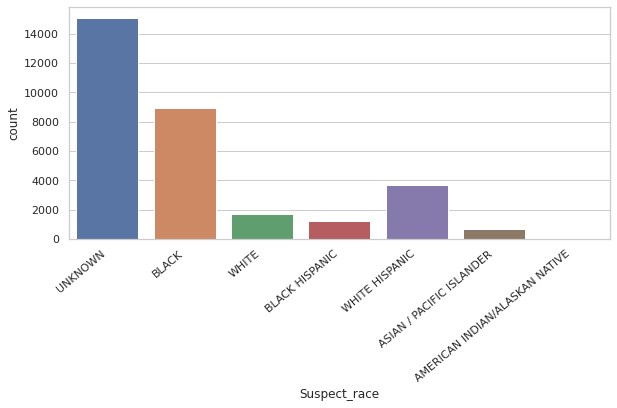

In [21]:
#Incidents by Suspect Race
ax = sns.countplot(x="Suspect_race", data=df)
dmp = ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")

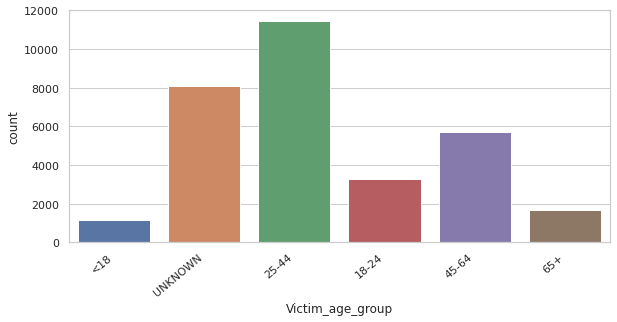

In [22]:
#Incidents by Victim Age_group
ax = sns.countplot(x="Victim_age_group", data=df)
dmp = ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")

Nearly the Third of victims (~11000 / ~31000) are between 25 and 44 years old.

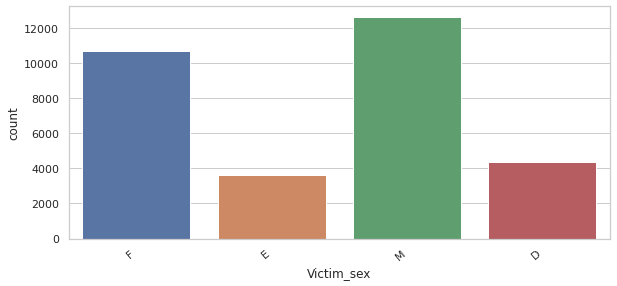

In [23]:
#Incidents by Victim Sex
ax = sns.countplot(x="Victim_sex", data=df)
dmp = ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")

#### In the Victim_sex feaure 'E' and 'D' refers to material objects
Victim's sex count doesn't imply much, Male Victims are slightly higher than Females.

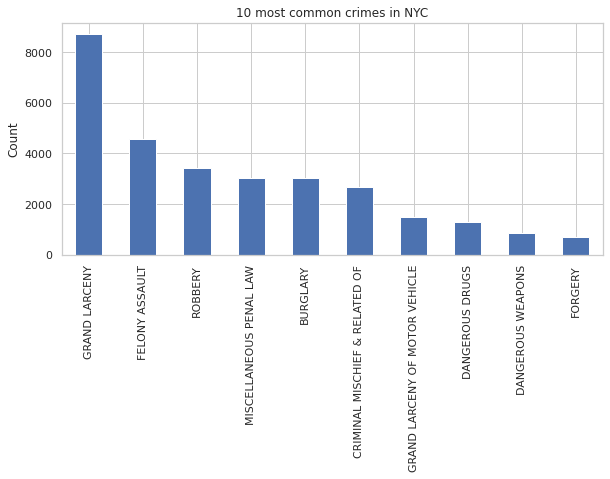

In [24]:
df['Offense'].value_counts()[:10].plot.bar()
plt.ylabel('Count')
plt.title('10 most common crimes in NYC')
plt.show()

Grand larceny (which is the theft of another’s property – including money – over a certain value) is the by far the most frequent incident. 

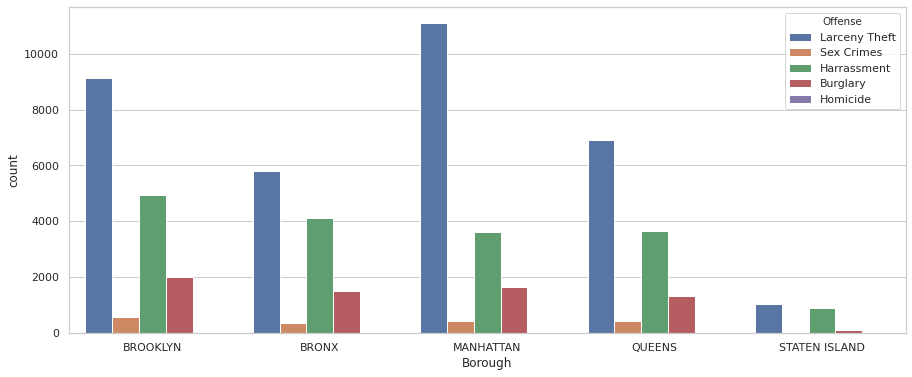

In [25]:
plt.figure(figsize=(15, 6))
grouped_df = complete_df
grouped_df.loc[grouped_df['Offense'].str.contains('SEX') | grouped_df['Offense'].str.contains('RAPE'), 'Offense'] = 'Sex Crimes'
grouped_df.loc[grouped_df['Offense'].str.contains('LARCENY') | grouped_df['Offense'].str.contains('THEFT'), 'Offense'] = 'Larceny Theft'
grouped_df.loc[grouped_df['Offense'].str.contains('HARRASSMENT'), 'Offense'] = 'Harrassment'
grouped_df.loc[grouped_df['Offense'].str.contains('BURGLAR') | grouped_df['Offense'].str.contains('ROBBERY'), 'Offense'] = 'Burglary'
grouped_df.loc[grouped_df['Offense'].str.contains('HOMICIDE') | grouped_df['Offense'].str.contains('MANSLAUGHTER'), 'Offense'] = 'Homicide'
grouped_df = grouped_df[(grouped_df['Offense'] == 'Sex Crimes')
                        | (grouped_df['Offense'] == 'Larceny Theft')
                        | (grouped_df['Offense'] == 'Harrassment')
                        | (grouped_df['Offense'] == 'Burglary')
                        | (grouped_df['Offense'] == 'Homicide')]
grouped_df = grouped_df[grouped_df['Borough'] != 'UNKNOWN']
ax = sns.countplot(x="Borough", hue="Offense", data=grouped_df)


### Observations:
#### Brooklyn
* Significantly high-frequent crime: Forgery, Burglary, Weapon Problem, Gambling, Robbery, Sex Crime & Social and Commercial-related Crime (Social_Commercial_related_Crime)
* Significantly low-frequent crime: High-Value Theft, Assault, Frauds & Offenses against Public

#### Manhattan
* Significantly high-frequent crime: High-Value Theft, Forgery & Sex Crime, Frauds
* Significantly low-frequent crime: Harassment, Assault, Serious Assault, Arson, Property Mischief, Weapon Problem, Driving under the Influence, Motor Vehicle Theft, Offenses against Public, Robbery, Social and Commercial-related Crime & Traffic Laws Violations

#### Bronx
* Significantly high-frequent crime: Serious Assault (Aggravated_Assault), Assault, Drug Problem, Weapon Problem, Harassment, Offenses against Public (Offenses_against_Public_Order_Administration) & Robbery
* Significantly low-frequent crime: High-Value Theft (Larceny_Theft) & Burglary

#### Queens
* Significantly high-frequent crime: Traffic Laws Violations, Assault, Burglary, Property Mischief, Harassment & Motor Vehicle Theft
* Significantly low-frequent crime: Drug Problem, Weapon Problem, Forgery, Frauds, Gambling, High-Value Theft, Offenses against Public

#### Staten Island
* Significantly high-frequent crime: Driving under the Influence, Property Mischief, Frauds, Harassment, Offenses against Public
* Significantly low-frequent crime: High-Value Theft, Serious Assault, Assault, Burglary, Drug Problem, Weapon Problem, Gambling, Motor Vehicle Theft, Robbery, Sex Crime, Social and Commercial-related Crime, Traffic Laws Violations

In [26]:
census_df = census_df.set_index('Borough').join(df[['Borough']].groupby('Borough').size().to_frame())
census_df.reset_index(inplace = True)
census_df.rename({0: 'Incidents_count'}, axis = 1, inplace = True)
census_df

,Borough,Percentage of Persons in Poverty,Per Capita Income,Median Household Income,Incidents_count
0,BROOKLYN,18.9,31984,56015,9481
1,MANHATTAN,15.6,72832,82459,7767
2,BRONX,27.3,20850,38085,6308
3,QUEENS,11.6,30289,64987,6677
4,STATEN ISLAND,11.7,34987,79267,1008


Let's plot the correlation matrix

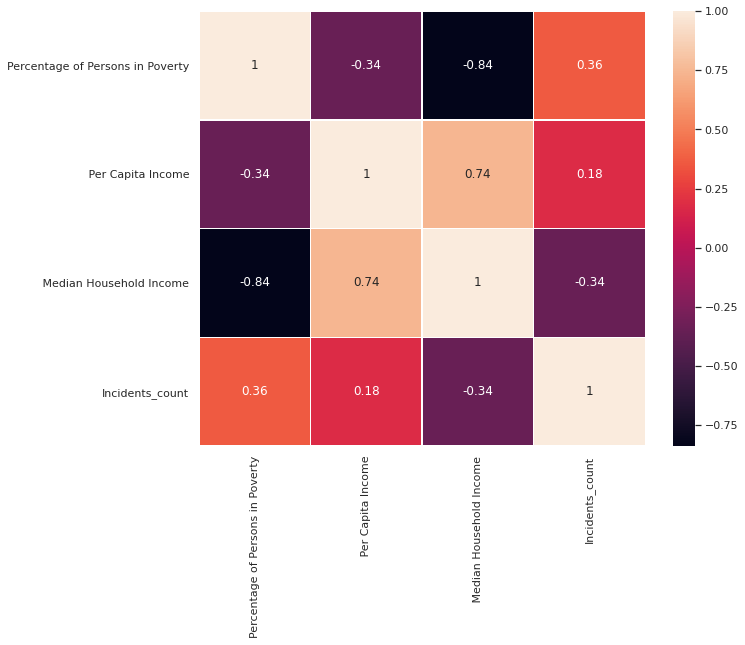

In [27]:
fig, ax = plt.subplots(figsize=(10,8))         # Sample figsize in inches
sns.heatmap(census_df.corr(), annot=True, linewidths=.5, ax=ax)

### Observations:
* Positive Correlation between Incidents_count and the Percentage of Poverty, the poorer the borough the higher the crime
* Negative Correlation between Incidents_count and Median Household Income.

### Another great way to understand the data is to visualize incidents locations using Folium

In [28]:
ny_longitude = -73.935242 # New York Longitude
ny_latitude = 40.730610 # New York Latitude
#instantiate a folium map for new york
ny_map = folium.Map(location=[ny_latitude, ny_longitude], zoom_start=10.5)
# instantiate a feature group for the incidents in the dataframe
incidents = folium.map.FeatureGroup()
# loop through the first 1000 crimes and add each to the incidents feature group
for i in range(0, 1000):
    label = '{}'.format(df['Offense'].iloc[i])
    incidents.add_child(
        folium.CircleMarker(
            [df['Latitude'].iloc[i], df['Longitude'].iloc[i]],
            radius=5, 
            color='yellow',
            popup = label,
            fill=True,
            fill_color='blue',
            fill_opacity=0.6
        )
    )

# add incidents to map
ny_map.add_child(incidents)

ny_map

* ### We can also visualize Incidents Clusters

In [29]:
ny_longitude = -73.935242 # New York Longitude
ny_latitude = 40.730610 # New York Latitude
#instantiate a folium map for new york
ny_map = folium.Map(location=[ny_latitude, ny_longitude], zoom_start=10.5)
# instantiate a MarkerCluster for the incidents in the dataframe
incidents = plugins.MarkerCluster().add_to(ny_map)
for i in range(0, len(df)):
    folium.Marker(
        location = [df['Latitude'].iloc[i], df['Longitude'].iloc[i]],
        icon=None,
        popup=label,
    ).add_to(incidents)
    
ny_map

The Visualization of Incidents Clusters confirms what we obtained in the count plots, we can observe that the biggest clusters are located in both Manhattan and Brooklyn while Staten Island have few clusters.

* #### Let's Exploit The Data imported from Foursqure to visualize the Venues with the most number of incidents (within 100 meters radius)

In [30]:
crimes_by_venue['marker_color'] = pd.cut(crimes_by_venue['Incidents_count'], bins=3, 
                              labels=['green', 'orange', 'red'])

In [31]:
ny_map = folium.Map(location=[ny_latitude, ny_longitude], zoom_start=10.5)

#The num of casulaties for each accident can be determined and the colour assigned then added to the basemap.
for i in range(0, 500):
    label = 'Venue:{}\
             Incidents {}'.format(crimes_by_venue['Venue'].iloc[i], crimes_by_venue['Incidents_count'].iloc[i])
    popup = folium.Popup(label, parse_html=True) 
    folium.Marker([crimes_by_venue['Venue Latitude'].iloc[i],crimes_by_venue['Venue Longitude'].iloc[i]],popup=popup, icon=folium.Icon(color=crimes_by_venue['marker_color'].iloc[i], icon='info-sign')).add_to(ny_map)

ny_map

#### Based on the map above, most of New York City Venues are safe (in term of number of Incidents that happened within a 100 meters radius) except a few Venues that were near a big number of incidents (Red Pins in the map)

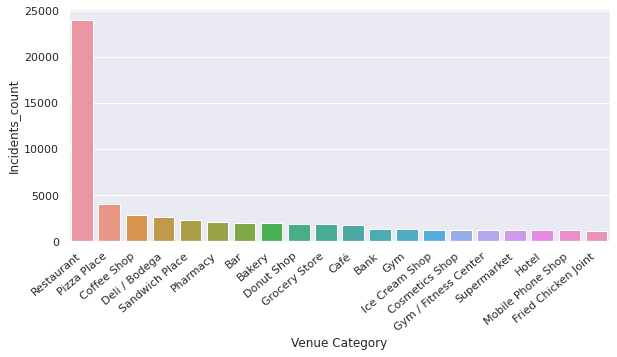

In [32]:
# Incidents count / Venue Category
sns.set(rc={'figure.figsize':(9.7,4.27)})
ax = sns.barplot(x="Venue Category", y="Incidents_count", data=crimes_by_venue_category[:20])
dmp = ax.set_xticklabels(ax.get_xticklabels(), rotation=40, ha="right")

Restaurants have the highest Incidents count (within 100 meters) because, probably, because they are everywhere across the city !

#### Let's Plot a Stacked Bar Chart to try and understand more the Offense - Venue relation 

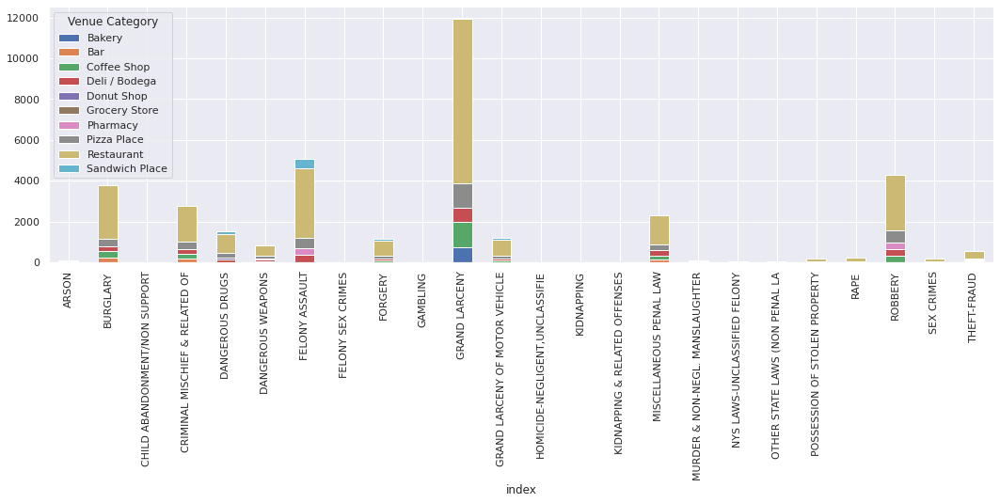

In [33]:
df_top10 = crimes_by_venue_category[0:10].transpose()
df_top10.columns = df_top10.iloc[0]
df_top10.drop(['Venue Category', 'Incidents_count'], inplace = True)
top10_by_incidents_count = (
    df_top10.reset_index()
    # make a long DF of date/column/name value
    .melt(id_vars='index')
    # order DF by highest values first
    .sort_values('value', ascending=False)
    # group by the index and take the first 3 rows of each
    .groupby('index')
    .head(5)
    # pivot back so we've got an X & Y to chart...
    .pivot('index', 'Venue Category')
    # drop the value level as we don't need that
    .droplevel(level=0, axis=1)
)
top10_by_incidents_count.plot(kind = 'bar', stacked=True, figsize=(18,5))

We can observe that grave incidents such as (Sex crimes, rape, homicides, kidnapping) often happen in isolated places with no venues around.

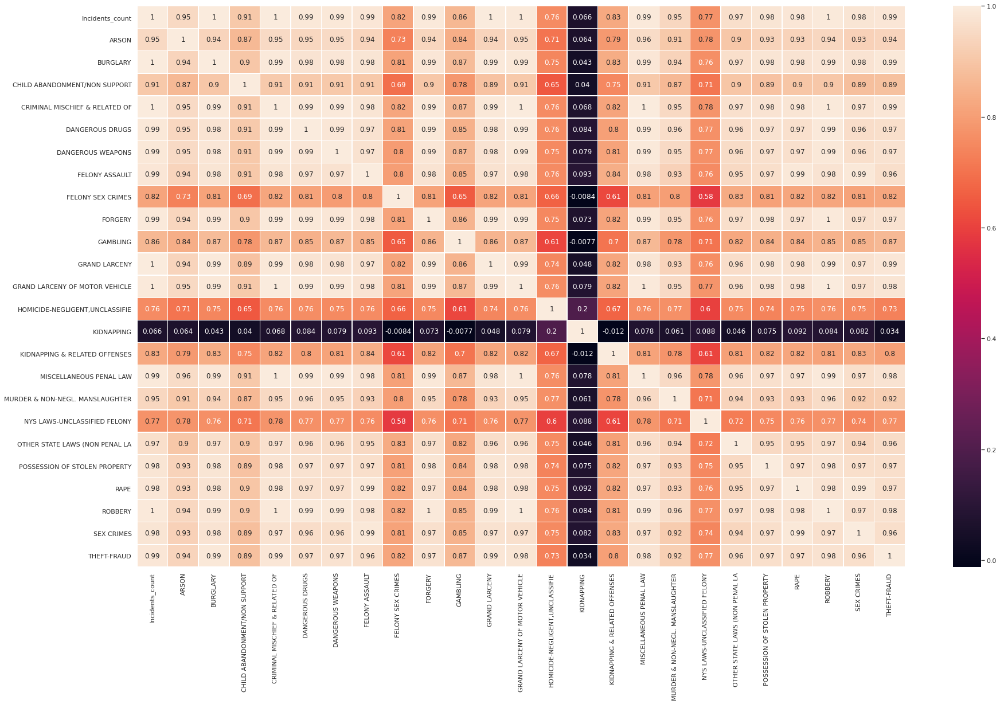

In [34]:
#Correlation Matrix By Venue Category
fig, ax = plt.subplots(figsize=(30,18))
sns.heatmap(crimes_by_venue_category.corr(), annot=True, linewidths=.5, ax=ax)

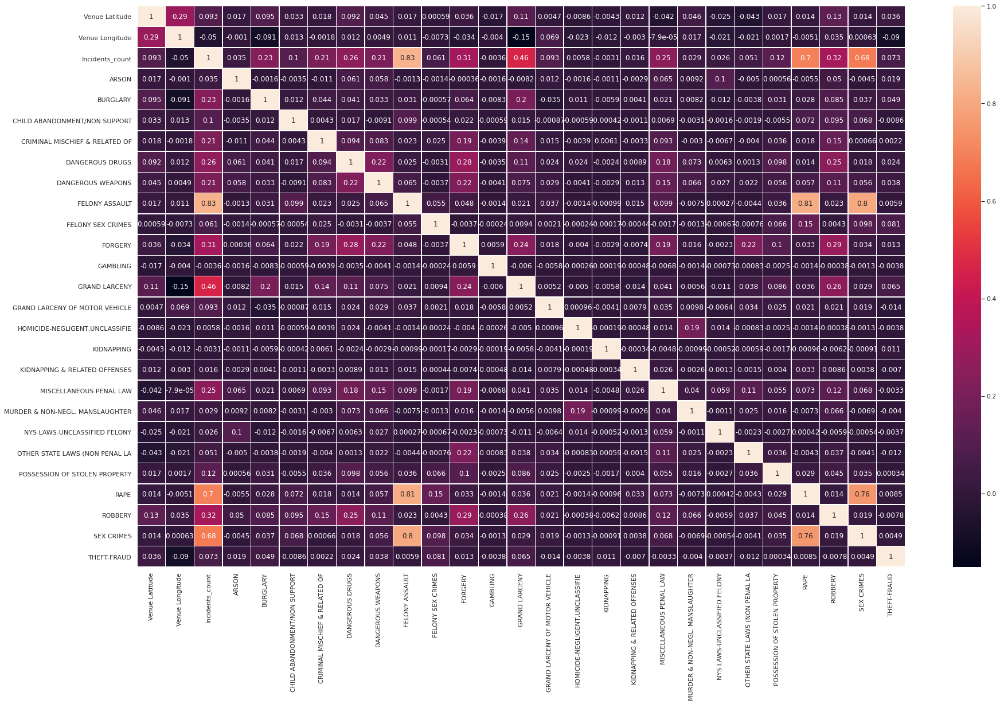

In [35]:
#Correlation Matrix By Venue
fig, ax = plt.subplots(figsize=(30,18))
sns.heatmap(crimes_by_venue.corr(), annot=True, linewidths=.5, ax=ax)

* We notice a correlation between Felony Assaults and Sex Crimes / Rape.
* We also notice a correlation between Sex Crimes and Rape, that maybe explained that the venues that are more isolated have more sex crimes / rape incidents in their surroindings than other venues
* There are Several other Correlation that are not very strong between multiple crimes.

In [36]:
crimes_by_venue.head()

,Venue Latitude,Venue Longitude,Venue,Incidents_count,ARSON,BURGLARY,CHILD ABANDONMENT/NON SUPPORT,CRIMINAL MISCHIEF & RELATED OF,DANGEROUS DRUGS,DANGEROUS WEAPONS,FELONY ASSAULT,FELONY SEX CRIMES,FORGERY,GAMBLING,GRAND LARCENY,GRAND LARCENY OF MOTOR VEHICLE,"HOMICIDE-NEGLIGENT,UNCLASSIFIE",KIDNAPPING,KIDNAPPING & RELATED OFFENSES,MISCELLANEOUS PENAL LAW,MURDER & NON-NEGL. MANSLAUGHTER,NYS LAWS-UNCLASSIFIED FELONY,OTHER STATE LAWS (NON PENAL LA,POSSESSION OF STOLEN PROPERTY,RAPE,ROBBERY,SEX CRIMES,THEFT-FRAUD,marker_color
0,40.671129,-73.882306,Wah On,225,0,6,0,0,1,2,193,0,1,0,1,1,0,0,0,2,0,0,0,0,6,1,11,0,red
1,40.671149,-73.882164,Bennett’s Pharmacy,224,0,6,0,0,1,2,193,0,1,0,1,0,0,0,0,2,0,0,0,0,6,1,11,0,red
2,40.671396,-73.881421,Golden China,223,0,5,0,0,1,2,193,0,1,0,1,0,0,0,0,2,0,0,0,0,6,1,11,0,red
3,40.810173,-73.924830,Dunkin',193,0,3,0,0,0,2,160,0,2,0,6,1,0,0,0,7,0,0,0,0,5,4,3,0,red
4,40.837514,-73.920771,El Caldero Restaurant & Sports Bar,168,0,0,0,0,0,0,162,0,0,0,0,0,0,0,0,0,0,0,0,0,5,0,1,0,red
